In [109]:
import pandas as pd
import numpy as np

dataAnimeList = pd.read_csv("data/animeListGenres.csv", error_bad_lines=False)
dataAnimeList = dataAnimeList.set_index("workId").sort_index().dropna()
dataAnimeList["genres"] = dataAnimeList["genres"].map(lambda x : x.split())
dataAnimeList = dataAnimeList[["jpName","genres","episodes"]]
dataAnimeList

b'Skipping line 3573: expected 6 fields, saw 7\nSkipping line 4558: expected 6 fields, saw 9\nSkipping line 4674: expected 6 fields, saw 7\nSkipping line 7929: expected 6 fields, saw 7\nSkipping line 8040: expected 6 fields, saw 8\nSkipping line 10119: expected 6 fields, saw 7\nSkipping line 10651: expected 6 fields, saw 7\nSkipping line 13106: expected 6 fields, saw 7\n'


,jpName,genres,episodes
workId,,,
1,カウボーイビバップ,"[Action,, Adventure,, Comedy,, Drama,, Sci-Fi,...",26
5,カウボーイビバップ 天国の扉,"[Action,, Drama,, Mystery,, Sci-Fi,, Space]",1
6,トライガン,"[Action,, Sci-Fi,, Adventure,, Comedy,, Drama,...",26
7,Witch Hunter ROBIN,"[Action,, Magic,, Police,, Supernatural,, Dram...",26
8,冒険王ビィト,"[Adventure,, Fantasy,, Shounen,, Supernatural]",52
...,...,...,...
39663,火の鳥”道後温泉編”,"[Historical,, Supernatural]",\N
39668,四月一日さん家の,"[Slice, of, Life]",\N
39701,七つの大罪 神々の逆鱗,"[Action,, Adventure,, Fantasy,, Magic,, Shoune...",\N


In [49]:
from tqdm import tqdm

def readAnimeReview():
    with open('data/    .csv', 'r', encoding='utf-8') as f:
        headers = f.readline().replace('"','').replace('\n','').split(',')
        print(headers)
        print('The number of column: ', len(headers))
        dataFormat = dict()
        for header in headers:
            dataFormat[header] = list()

        for idx, line in enumerate(tqdm(f.readlines(), desc='Now parsing... ')):
            
            if idx == 67:
                yee = line
            
            if line != '':
                line = line.replace('\n','')
                indices = [i for i, x in enumerate(line) if x == ',']
                idxStart = 0
                for i in range(len(headers)):
                    if i < len(headers) - 1:
                        dataFormat[headers[i]].append(line[idxStart + 1:indices[i] - 1])
                        idxStart = indices[i] + 1
                    elif i == len(headers) - 1:
                        dataFormat[headers[i]].append(line[idxStart + 1:-1])
                    else:
                        break
    return dataFormat

In [193]:
animereview = pd.DataFrame(readAnimeReview())
animereview

['id', 'workId', 'reviewId', 'workName', 'postTime', 'episodesSeen', 'author', 'peopleFoundUseful', 'overallRating', 'storyRating', 'animationRating', 'soundRating', 'characterRating', 'enjoymentRating', 'review']
The number of column:  15


Now parsing... : 100%|██████████| 135206/135206 [00:32<00:00, 4185.79it/s]


,id,workId,reviewId,workName,postTime,episodesSeen,author,peopleFoundUseful,overallRating,storyRating,animationRating,soundRating,characterRating,enjoymentRating,review
0,8121,1,1,Cowboy_Bebop,2006-11-07 18:34:00,26,Xinil,162,10,8,10,10,10,10,Cowboy Bebop is an episodic series. By episodi...
1,63480,856,9,Utawarerumono,2006-11-08 00:24:00,26,Crystal,218,8,8,7,7,9,8,Utawarerumono manages to be one of those harem...
2,8452,263,10,Hajime_no_Ippo,2006-11-08 14:39:00,76,Xinil,827,10,10,9,9,10,10,"First, let me say that I\\'m not a fan of boxi..."
3,66544,129,11,Gensoumaden_Saiyuuki,2006-11-09 05:22:00,50,Chelle,69,9,8,6,7,10,9,Saiyuki is one of those animes that just grabs...
4,55936,210,12,Ranma_½,2006-11-09 16:48:00,161,running_lemon,40,7,6,8,8,8,7,A comedy/romance based on the manga by Rumiko ...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
135201,1114379,12445,309957,Tasogare_Otome_x_Amnesia,2019-06-07 06:09:00,12,aidenszz,2,7,8,5,6,7,7,Hello Welcome to the top of underground anime....
135202,1114378,1,309958,Cowboy_Bebop,2019-06-07 07:19:00,26,aidenszz,4,8,6,8,10,7,8,"[review without spoilers]Cowboy Bebop, a true ..."
135203,1114377,30736,309959,Shingeki_no_Bahamut__Virgin_Soul,2019-06-07 08:28:00,24,aidenszz,1,5,0,0,0,0,0,I just cannot understand why this show is rate...
135204,1114376,539,309960,Tenchi_Muyou_Ryououki,2019-06-07 08:42:00,6,aidenszz,1,10,10,10,10,10,10,Tenchi Muyou Ryououki is a classic cult must w...


In [194]:
animereview = animereview[["reviewId","workName","postTime","episodesSeen","peopleFoundUseful","overallRating","review"]].dropna()
animereview = animereview.set_index("reviewId")
animereview["overallRating"] = animereview["overallRating"].astype(int)

In [195]:
animereview.loc[animereview["overallRating"] > 10]
animereview = animereview.drop(index="252847")

In [196]:
animereview.to_csv("data/data_clean/animereview.csv")

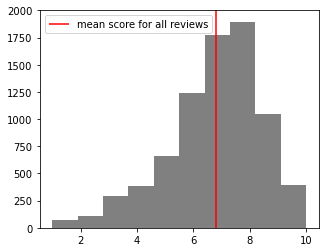

In [187]:
scoreDict = {}
for i in animereview.values:
    if i[0] in scoreDict:
        scoreDict[i[0]].append(int(i[1]))
    else:
        scoreDict[i[0]] = [int(i[1])]
scoreList = [np.mean(scoreDict[i]) for i in scoreDict]
from matplotlib import pyplot as plt

plt.figure(figsize=(5,4))
plt.ylim(0,2000)
plt.hist(scoreList, bins=10, color="gray")
plt.vlines(np.mean(scoreList),0,2000, colors="red", label="mean score for all reviews")
plt.legend()
plt.savefig("figures/fig_data_distribution1.png",dpi=200)

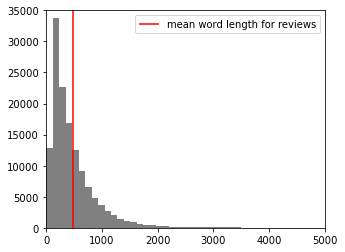

In [188]:
wordlenList = animereview["review"].map(lambda x: len(x.split()))

plt.figure(figsize=(5,4))
plt.ylim(0,35000)
plt.xlim(0,5000)
plt.hist(wordlenList, bins=100, color="gray")
plt.vlines(np.mean(wordlenList),0,35000, colors="red", label="mean word length for reviews")
plt.legend()
plt.savefig("figures/fig_data_distribution2.png",dpi=200)

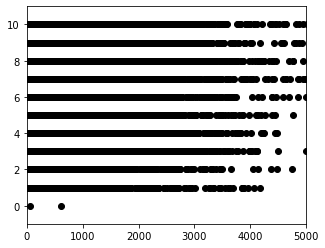

In [191]:
wordlenList = animereview["review"].map(lambda x: len(x.split()))

plt.figure(figsize=(5,4))
plt.xlim(0,5000)
plt.ylim(-1,11)
plt.scatter(wordlenList, animereview["overallRating"], color="black")
# plt.legend()
plt.savefig("figures/fig_review_lenrelation.png",dpi=200)

In [81]:
from typing import Dict, List, Optional
from collections import Counter

class Tokenizer:
    def __init__(self):
        # two special tokens for padding and unknown
        self.token2idx = {"<pad>": 0, "<unk>": 1}
        self.idx2token = ["<pad>", "<unk>"]
        self.is_fit = False
    
    @property
    def pad_id(self):
        return self.token2idx["<pad>"]
    
    def __len__(self):
        return len(self.idx2token)
    
    def fit(self, train_texts: List[str]):
        counter = Counter()
        for text in tqdm(train_texts):
            counter.update(text.lower().split())
        
        # manually set a vocabulary size for the data set
        vocab_size = 20000
        self.idx2token.extend([token for token, count in counter.most_common(vocab_size - 2)])
        for (i, token) in enumerate(self.idx2token):
            self.token2idx[token] = i
            
        self.is_fit = True
                
    def encode(self, text: str, max_length: Optional[int] = None) -> List[int]:
        if not self.is_fit:
            raise Exception("Please fit the tokenizer on the training tokens")
        
        tokens = text.lower().split()
        token_ids = [self.token2idx.get(token, self.token2idx["<unk>"]) for token in tokens]

        if max_length is not None:
            # truncate or pad the token_ids to max_length
            if len(token_ids) > max_length:
                token_ids = token_ids[:max_length]
            else:
                token_ids += [self.token2idx["<pad>"]] * (max_length - len(token_ids))

        return token_ids

In [80]:
tokenizer = Tokenizer()
tokenizer.fit(animereview["review"])
len(tokenizer.token2idx)

100%|██████████| 135206/135206 [00:16<00:00, 8354.12it/s]


Counter({'the': 3669799, 'and': 1788468, 'to': 1577336, 'of': 1573893, 'a': 1558858, 'is': 1191557, 'i': 982431, 'it': 885556, 'in': 872771, 'that': 863821, 'this': 705605, 'but': 537939, 'for': 515403, 'with': 485870, 'as': 485085, 'was': 466508, 'you': 442309, 'are': 402954, 'not': 345652, 'anime': 331690, 'be': 318187, 'they': 293777, 'have': 292825, 'on': 287703, 'like': 283402, 'just': 251643, 'characters': 242769, 'so': 242735, 'all': 233872, 'one': 233829, 'at': 233575, 'really': 225447, 'an': 224376, 'from': 217813, 'or': 214715, 'if': 209418, 'more': 207295, 'story': 206594, 'some': 204777, 'show': 201975, 'about': 199978, "it's": 197676, 'very': 184671, 'what': 183486, 'there': 180961, 'he': 178661, 'has': 177322, 'my': 173407, 'character': 172476, 'by': 166885, 'their': 166479, 'her': 163892, 'his': 160225, 'can': 157905, 'who': 157153, 'even': 152092, 'because': 148986, 'no': 146501, 'out': 144508, 'good': 143961, 'when': 139316, 'me': 139292, 'which': 138739, 'much': 13825

20000

In [82]:
animereview["review encode"] = animereview["review"].map(lambda x : tokenizer.encode(x))

In [107]:
tokenizer.token2idx

{'<pad>': 0,
 '<unk>': 1,
 'the': 2,
 'and': 3,
 'to': 4,
 'of': 5,
 'a': 6,
 'is': 7,
 'i': 8,
 'it': 9,
 'in': 10,
 'that': 11,
 'this': 12,
 'but': 13,
 'for': 14,
 'with': 15,
 'as': 16,
 'was': 17,
 'you': 18,
 'are': 19,
 'not': 20,
 'anime': 21,
 'be': 22,
 'they': 23,
 'have': 24,
 'on': 25,
 'like': 26,
 'just': 27,
 'characters': 28,
 'so': 29,
 'all': 30,
 'one': 31,
 'at': 32,
 'really': 33,
 'an': 34,
 'from': 35,
 'or': 36,
 'if': 37,
 'more': 38,
 'story': 39,
 'some': 40,
 'show': 41,
 'about': 42,
 "it's": 43,
 'very': 44,
 'what': 45,
 'there': 46,
 'he': 47,
 'has': 48,
 'my': 49,
 'character': 50,
 'by': 51,
 'their': 52,
 'her': 53,
 'his': 54,
 'can': 55,
 'who': 56,
 'even': 57,
 'because': 58,
 'no': 59,
 'out': 60,
 'good': 61,
 'when': 62,
 'me': 63,
 'which': 64,
 'much': 65,
 'its': 66,
 'how': 67,
 'she': 68,
 'series': 69,
 'would': 70,
 'first': 71,
 'only': 72,
 'were': 73,
 'will': 74,
 'other': 75,
 'also': 76,
 'most': 77,
 'up': 78,
 'get': 79,
 'int

In [101]:
from functools import reduce

li = reduce(lambda x,y : x + y, animereview["review encode"].iloc[:1000].to_list())

In [106]:
pd.value_counts(li)

1        29340
2        24522
3        11691
5        10203
6         9690
         ...  
19907        1
10628        1
8707         1
13772        1
8001         1
Length: 14444, dtype: int64